In [9]:
import pandas as pd
import os
import random
import matplotlib.pyplot as plt
import numpy as np
import shutil
import gc

from scipy.signal import stft
from scipy.io import wavfile
from scipy.signal import resample

import torch
import audiomentations as a
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

from audiomentations import AddGaussianNoise, PitchShift, TimeMask, SpecFrequencyMask, Normalize, AddGaussianSNR

import faiss
from faiss import write_index, read_index

from datetime import datetime

from model import tensorify, ResNet, loss_function

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# save pickles in a dictionary to reference later
pickles = {}
for file in os.listdir("data/Pickle Folder"):
    f = os.path.splitext(file)[0]
    pickles[f] = pd.read_pickle("data/Pickle Folder/" + file)

In [10]:
# process signal data before passing into the model
def normalise(data, sr):
    data = data.astype(np.float32)
    data = resample(data, int(len(data)/sr*8000))
    f, t, Zxx = stft(data, 8000, nfft=1024)
    Zxx = np.abs(Zxx)
    
    # normalisation
    Zxx = Zxx + 1
    Zxx = np.log(Zxx)
    Zxx = Zxx/np.median(Zxx)
    
    return f, t, Zxx

def plot_spec(t, f, Zxx, title="Spectrogram", cmap="magma"):
    plt.pcolormesh(t, f, np.abs(Zxx), cmap=cmap)
    plt.xlabel('Time')
    plt.ylabel('Frequency')
    plt.title(title)
    plt.colorbar()
    plt.show()

# print information about the signal type
def read_and_print_file(file_path):
    try:
        with open(file_path, 'r') as file:
            file_contents = file.read()
            if file_contents.strip():  # Check if the file is not empty
                print(file_contents + "\n")
    except FileNotFoundError:
        print(f"File not found: {file_path}")
    except Exception as e:
        print(f"Error occurred: {e}")

# retrieve datetime of signal from the file name
def get_datetime(file_name):
    file_name = os.path.basename(file_name)
    timestamp = int(file_name.split("_")[1])
    return datetime.fromtimestamp(timestamp)

# output the k most similar signals given the file and the database
def get_k_most_similar(file, cosineIndex, database, model, k):    
    test_arr = np.zeros((1, 128), dtype=np.float32)
    
    # produce embedding for test signal
    with torch.no_grad():
        sample_rate, data = wavfile.read(file)
        f, t, spec = normalise(data, sample_rate)
        print(f"Tested Signal:")
        plot_spec(t, f, spec)
        spec = tensorify(spec)
        spec = spec.to(device)
        embedding = model(spec)
        test_arr[0]=embedding.cpu().numpy()
        
    test_arr = np.array(test_arr).astype(np.float32)
    test_arr /= np.linalg.norm(test_arr, axis=1, keepdims=True)
    
    # search index for most similar signals
    distance, I2 = cosineIndex.search(test_arr, k+1)
    
    # get majority vote of the signals
    votes = {}
    for j in range(1, k+1):
        idx = I2[0][j]
        folder_name = os.path.basename(os.path.dirname(database[idx]))
        train_file_name = os.path.basename(database[idx])
        train_file_name = os.path.splitext(train_file_name)[0]
        datetime = get_datetime(train_file_name)
        types = pickles[folder_name]['GTLabelnamesAll'][train_file_name]
        
        for type in types:
            if type not in votes:
                votes[type] = 0
            votes[type] += 1 
        
        print(f"Number {j} most similar trained signal: {train_file_name}, Types: {types}, Similarity: {distance[0][j]}\n")
        print("Seen on:", datetime.strftime("%Y-%m-%d %H:%M:%S"))
        sample_rate, data = wavfile.read(database[idx])
        f, t, spec = normalise(data, sample_rate)
        plot_spec(t, f, spec)
        
    label = max(votes, key=votes.get)
    print(f"The signal is most likely a {label} signal.\n")
    read_and_print_file("information/" + label + ".txt")

In [11]:
dir = "data/labelled"

folder_path = os.path.join(dir, "FB_18Dec2019_specgenCL0005_ShortPatience")
test_files = [os.path.join(folder_path, file) for file in os.listdir(folder_path) if file.endswith('.wav')]

print("Number of test files:", len(test_files))

Number of test files: 954


In [42]:
# load the trained model for evaluation
model = ResNet(128).to(device)
embedding_size = 128

model_name = "lr5e-05b32_3107_50_remove_10_nofreeze__finetuned_lr5e-05"
epoch_num = 30
model_path = f"final_results/{model_name}_{str(epoch_num)}.pth"
model.load_state_dict(torch.load(model_path))

model.eval()

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): ResBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (shortcut): Identity()
    )
    (1): ResBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (rel

In [43]:
# create tensors for the database and build an index using it
dir = "final_results/indexes"
if not os.path.exists(dir):
    os.makedirs(dir)
index_path = f"{dir}/{model_name}_{str(epoch_num)}.index"

cosineIndex = faiss.IndexFlatIP(embedding_size)
test_arr = np.zeros((len(test_files), 128), dtype=np.float32)
test_arr_idx=0
for wav_file in test_files:
    with torch.no_grad():
        sample_rate, data = wavfile.read(wav_file)
        f, t, spec = normalise(data, sample_rate)
        spec = tensorify(spec)
        spec = spec.to(device)
        embedding = model(spec)
        del spec
        test_arr[test_arr_idx]=embedding.cpu().numpy()
        del embedding
        test_arr_idx+=1
        print(test_arr_idx, end="\r")
test_arr_tmp = np.array(test_arr).astype(np.float32)
test_arr_tmp /= np.linalg.norm(test_arr_tmp, axis=1, keepdims=True)
    

if os.path.isfile(index_path):
    cosineIndex = faiss.read_index(index_path)
else:
    cosineIndex.add(test_arr_tmp)
    write_index(cosineIndex, index_path)

Tested Signal:


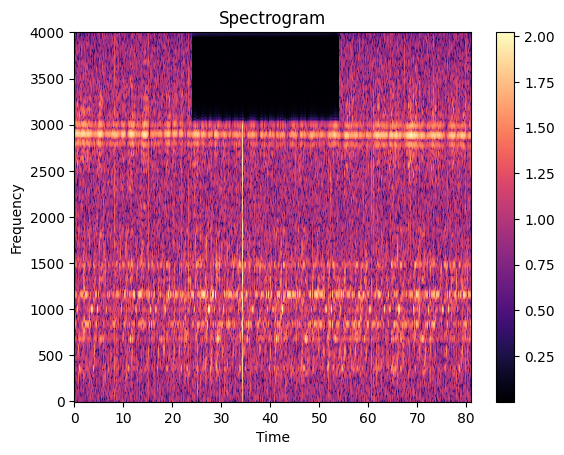

Number 1 most similar trained signal: 6445000_1576683120_6449000_1576683210, Types: ['JSM'], Similarity: 0.9522086381912231

Seen on: 2019-12-18 15:32:00


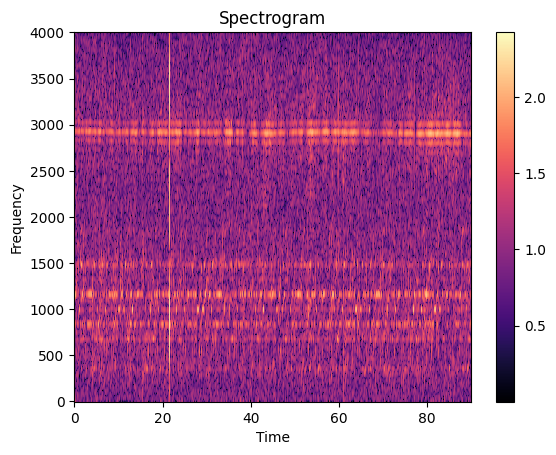

Number 2 most similar trained signal: 6444000_1576682580_6448000_1576682640, Types: ['JSM'], Similarity: 0.9452607035636902

Seen on: 2019-12-18 15:23:00


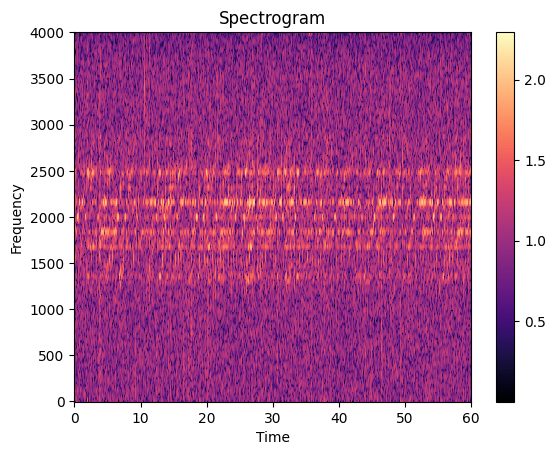

Number 3 most similar trained signal: 6445000_1576683711_6449000_1576683780, Types: ['JSM'], Similarity: 0.9311777949333191

Seen on: 2019-12-18 15:41:51


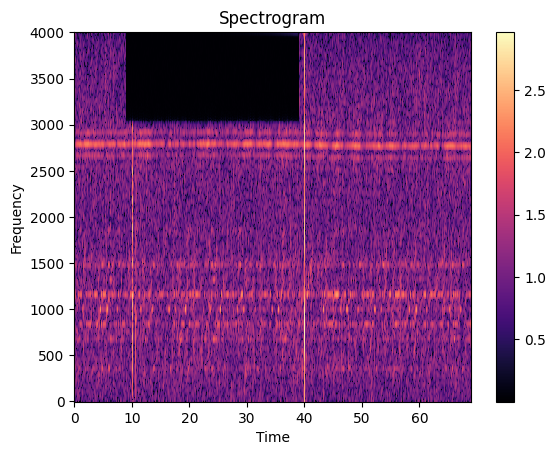

The signal is most likely a JSM signal.

JSM stands for "Jump Set Marker" and is a type of signal used in radio communications and telecommunications. JSM signals are short bursts of radio frequency transmitted to mark specific points or events within a data transmission or communication sequence.

In the context of radio communications, JSM signals are used for various purposes, including synchronization, timing, and error correction. They serve as reference markers that help receivers identify specific portions of transmitted data, allowing for accurate data retrieval and decoding.

JSM signals are commonly used in digital communication systems, such as satellite communication, wireless communication, and data transmission over networks. They play a critical role in ensuring the integrity and reliability of the transmitted data, especially in environments with potential signal interference or noise.

Tested Signal:


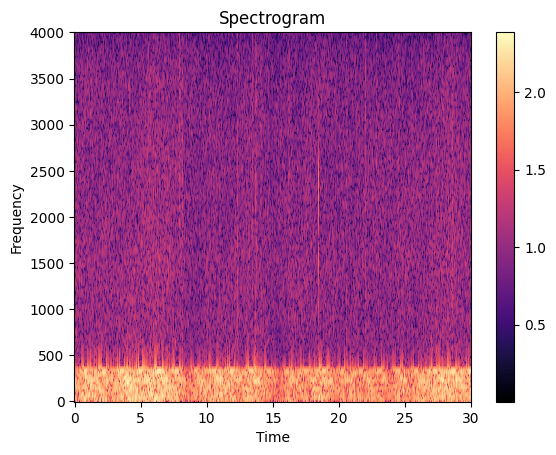

Number 1 most similar trained signal: 7554500_1576681860_7558500_1576681893, Types: ['TopNoise'], Similarity: 0.9882639050483704

Seen on: 2019-12-18 15:11:00


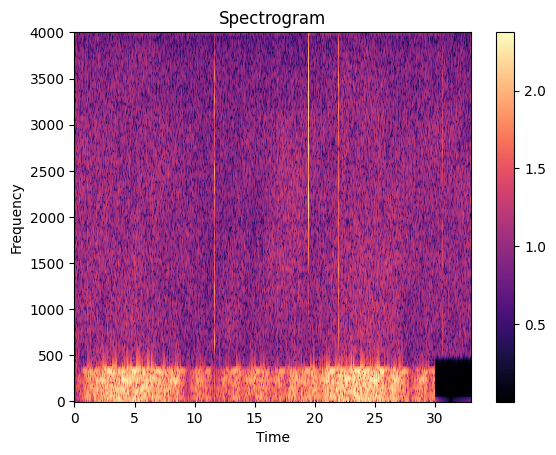

Number 2 most similar trained signal: 6408000_1576681710_6412000_1576681770, Types: ['Tone'], Similarity: 0.9473739266395569

Seen on: 2019-12-18 15:08:30


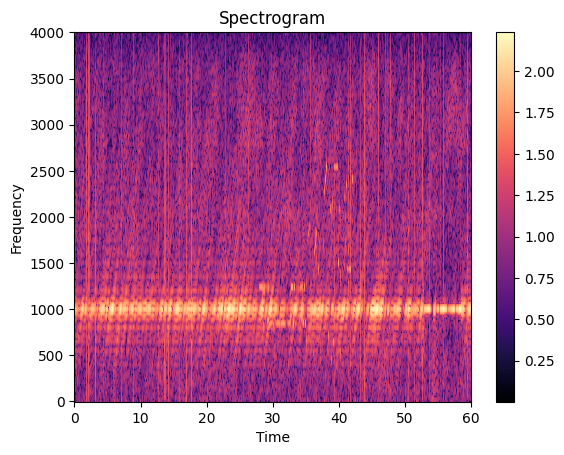

Number 3 most similar trained signal: 6408000_1576681530_6412000_1576681584, Types: ['Tone'], Similarity: 0.9454772472381592

Seen on: 2019-12-18 15:05:30


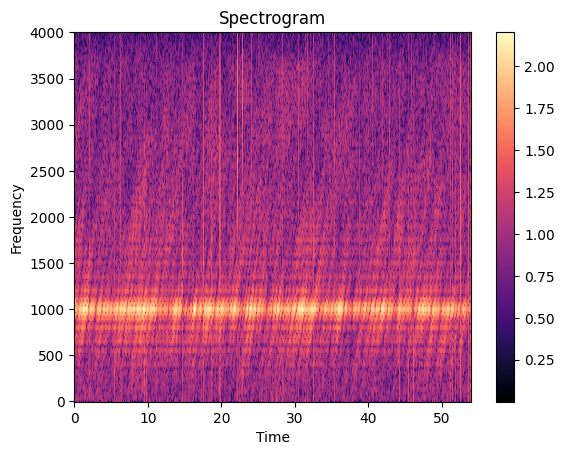

The signal is most likely a Tone signal.

Tone, in the context of signals and communications, refers to a continuous wave (CW) signal that consists of a single frequency. It is characterized by its steady and constant amplitude and does not contain any modulation or variations in frequency or amplitude over time.

Tones are fundamental components used in various applications, such as audio communication, musical instruments, and telecommunications. In audio communication, tones are used for generating simple sounds, like the dial tones on a telephone or alert tones in devices. In music, tones represent specific musical notes with distinct frequencies.

In telecommunications, tones are essential for signaling purposes. For example, Dual-Tone Multi-Frequency (DTMF) tones are used in touch-tone phones to represent different digits, while other tones may signify specific events or conditions in communication systems.

Tones are also used in signal processing and testing, where they can be 

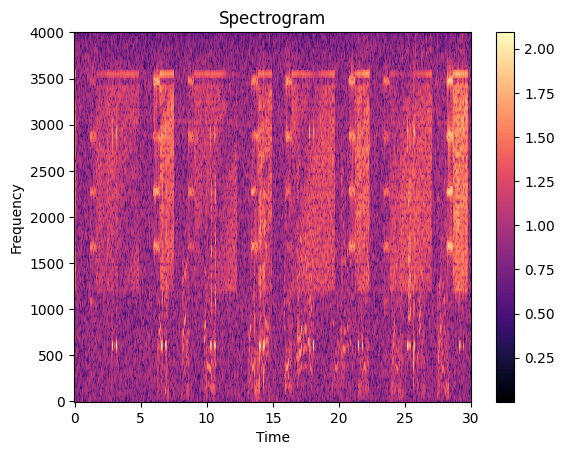

Number 1 most similar trained signal: 6688000_1576684110_6692000_1576684170, Types: ['Link11', 'ReversedE'], Similarity: 0.9963423609733582

Seen on: 2019-12-18 15:48:30


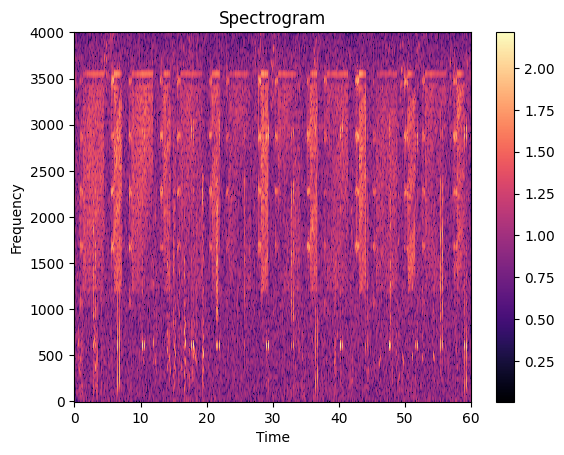

Number 2 most similar trained signal: 6689000_1576684470_6693000_1576684500, Types: ['ReversedE', 'Speech'], Similarity: 0.9751399159431458

Seen on: 2019-12-18 15:54:30


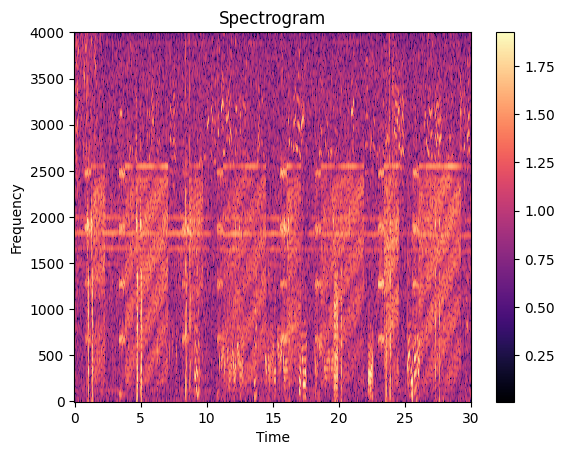

Number 3 most similar trained signal: 6688000_1576684230_6692000_1576684260, Types: ['Link11', 'ReversedE'], Similarity: 0.9728444814682007

Seen on: 2019-12-18 15:50:30


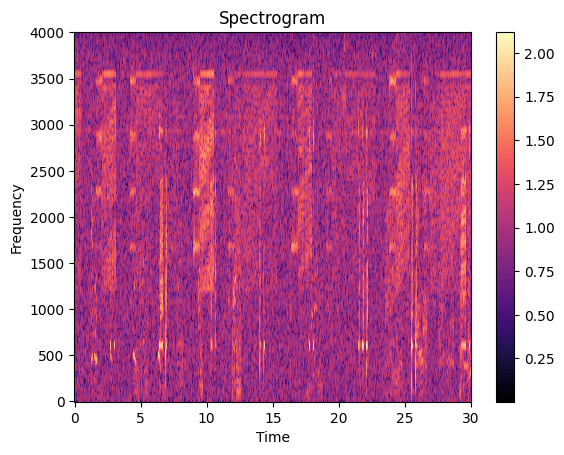

The signal is most likely a ReversedE signal.

"Reversed E" likely refers to "Reversed E-Skip," a radio propagation phenomenon where signals travel in the opposite direction of their typical path, bouncing off the ionosphere and returning to the Earth's surface. This can facilitate long-range radio communications and is of interest to radio enthusiasts and amateur radio operators.

Tested Signal:


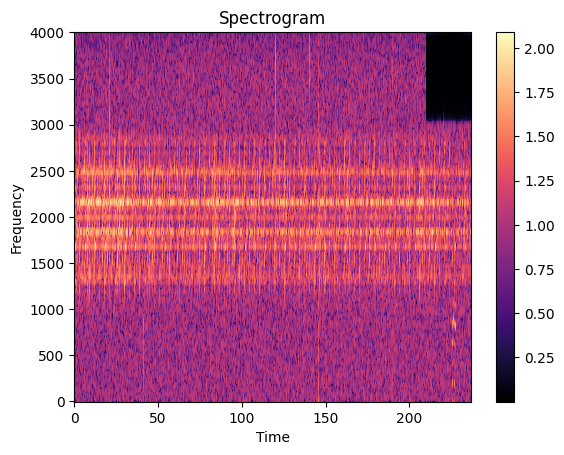

Number 1 most similar trained signal: 6416000_1576681890_6420000_1576682010, Types: ['JSM'], Similarity: 0.9957234859466553

Seen on: 2019-12-18 15:11:30


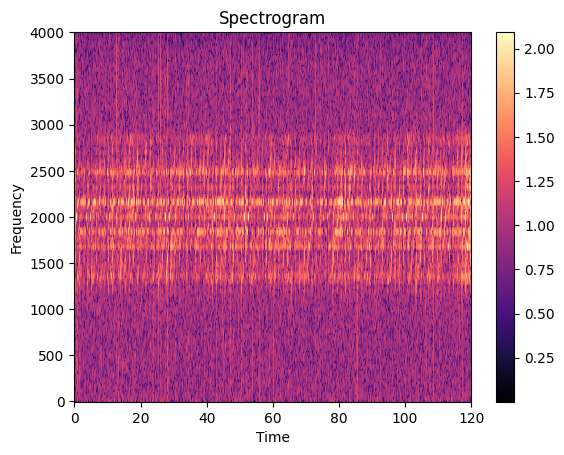

Number 2 most similar trained signal: 8587000_1576684260_8591000_1576684440, Types: ['JSM'], Similarity: 0.9948504567146301

Seen on: 2019-12-18 15:51:00


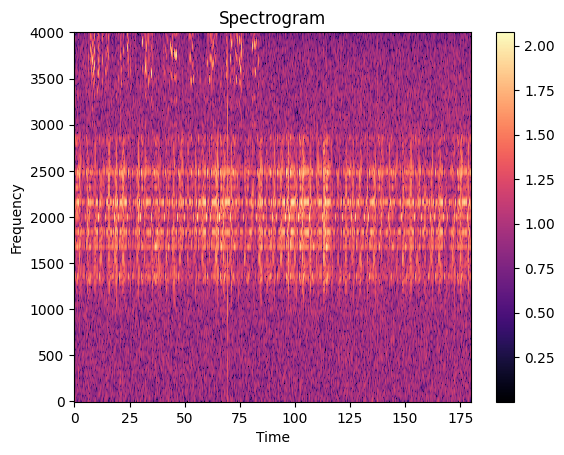

Number 3 most similar trained signal: 8587000_1576683702_8591000_1576683810, Types: ['JSM'], Similarity: 0.9940420389175415

Seen on: 2019-12-18 15:41:42


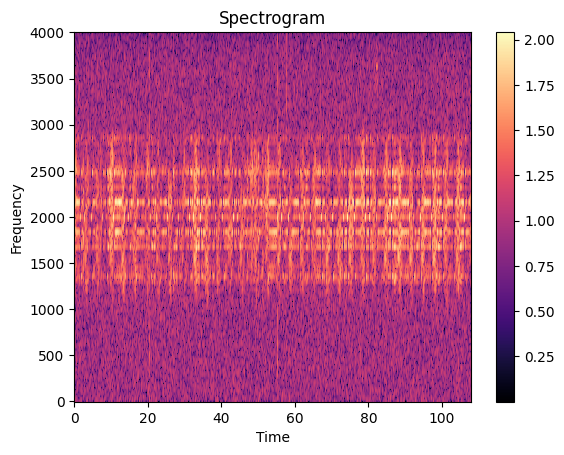

The signal is most likely a JSM signal.

JSM stands for "Jump Set Marker" and is a type of signal used in radio communications and telecommunications. JSM signals are short bursts of radio frequency transmitted to mark specific points or events within a data transmission or communication sequence.

In the context of radio communications, JSM signals are used for various purposes, including synchronization, timing, and error correction. They serve as reference markers that help receivers identify specific portions of transmitted data, allowing for accurate data retrieval and decoding.

JSM signals are commonly used in digital communication systems, such as satellite communication, wireless communication, and data transmission over networks. They play a critical role in ensuring the integrity and reliability of the transmitted data, especially in environments with potential signal interference or noise.

Tested Signal:


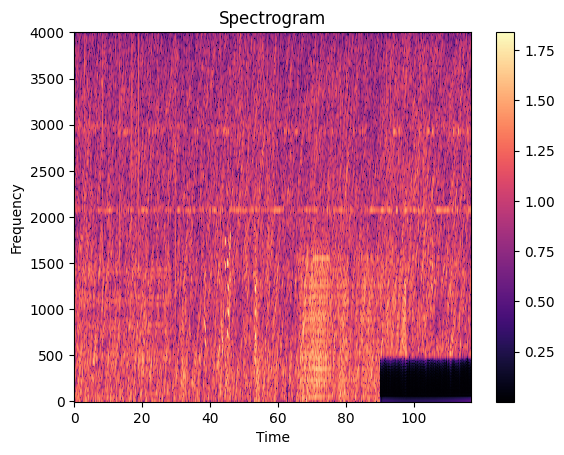

Number 1 most similar trained signal: 6351000_1576682550_6355000_1576682580, Types: ['Noise'], Similarity: 0.9852516651153564

Seen on: 2019-12-18 15:22:30


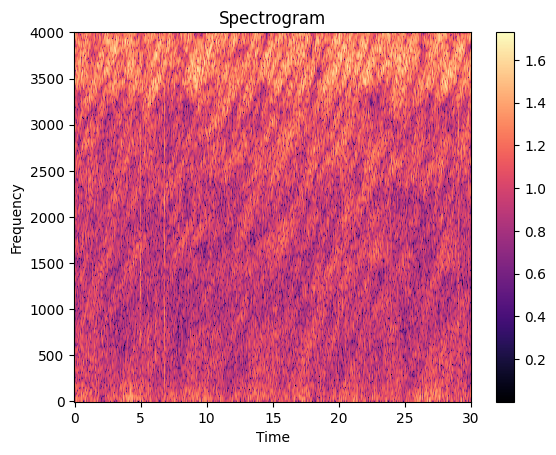

Number 2 most similar trained signal: 7041000_1576684530_7045000_1576684560, Types: ['TonePair'], Similarity: 0.984443187713623

Seen on: 2019-12-18 15:55:30


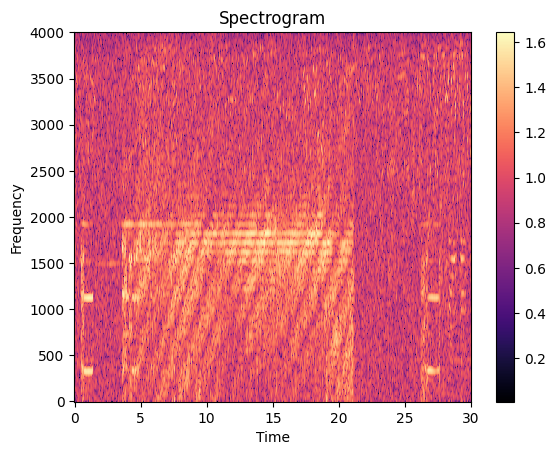

Number 3 most similar trained signal: 7551500_1576682190_7555500_1576682460, Types: ['DRM'], Similarity: 0.9817354679107666

Seen on: 2019-12-18 15:16:30


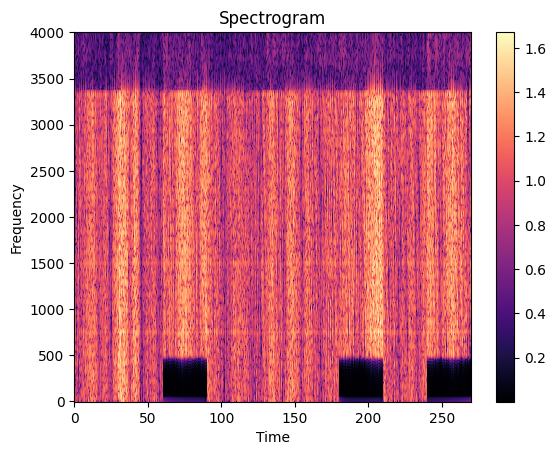

The signal is most likely a Noise signal.

Tested Signal:


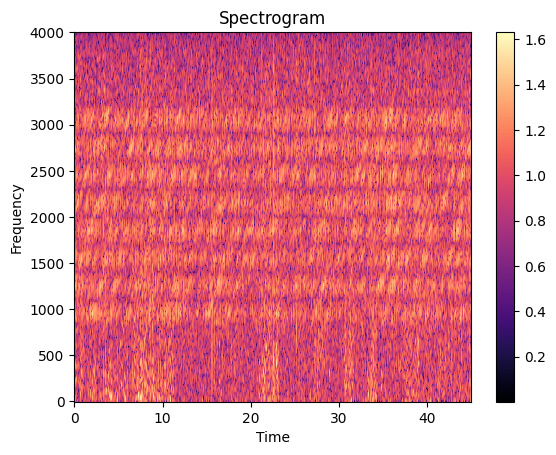

Number 1 most similar trained signal: 6392000_1576684350_6396000_1576684383, Types: ['J8'], Similarity: 0.9470495581626892

Seen on: 2019-12-18 15:52:30


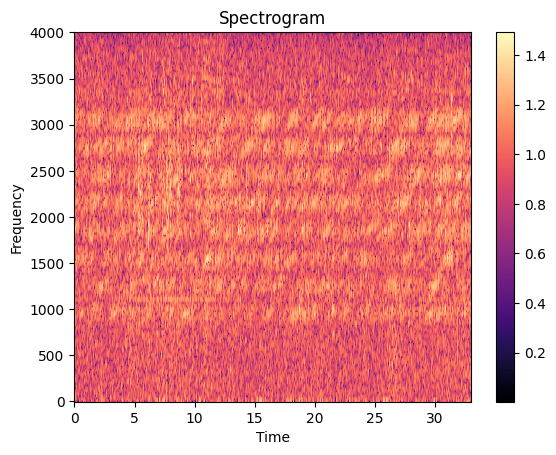

Number 2 most similar trained signal: 6392000_1576684710_6396000_1576684740, Types: ['J8'], Similarity: 0.9349614381790161

Seen on: 2019-12-18 15:58:30


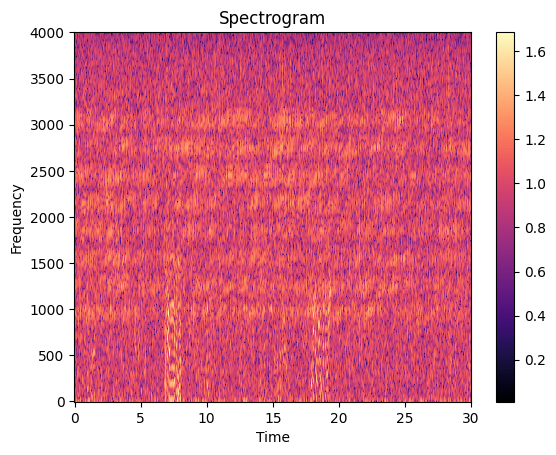

Number 3 most similar trained signal: 8551000_1576682370_8555000_1576682430, Types: ['J8'], Similarity: 0.9278817176818848

Seen on: 2019-12-18 15:19:30


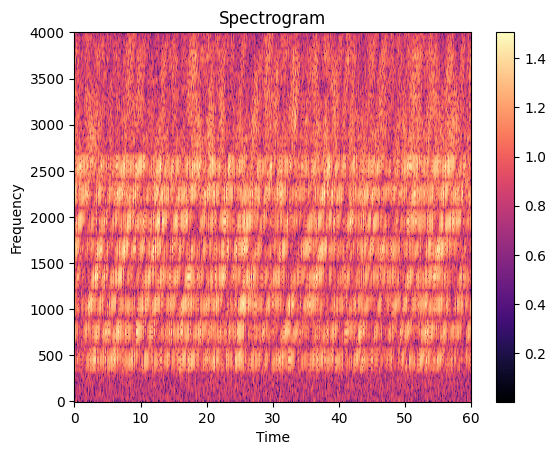

The signal is most likely a J8 signal.

J8 is a signal type used in ionospheric research and radio frequency (RF) communication systems. It is one of the many signals transmitted for ionospheric sounding and is commonly used in radar and radio wave propagation studies.

J8 signals are typically modulated with a specific waveform and transmitted vertically into the ionosphere. The signal interacts with the ionospheric electrons, and the reflected signal provides valuable information about the electron density and other ionospheric properties at different altitudes.

Researchers and scientists use J8 signals to study the behavior of the ionosphere, which is a critical part of the Earth's upper atmosphere. The ionosphere contains a high concentration of ions and free electrons, and it plays a crucial role in the propagation of radio waves. Understanding the ionospheric behavior is essential for improving radio communication, satellite navigation systems, and space weather predictions.

J8

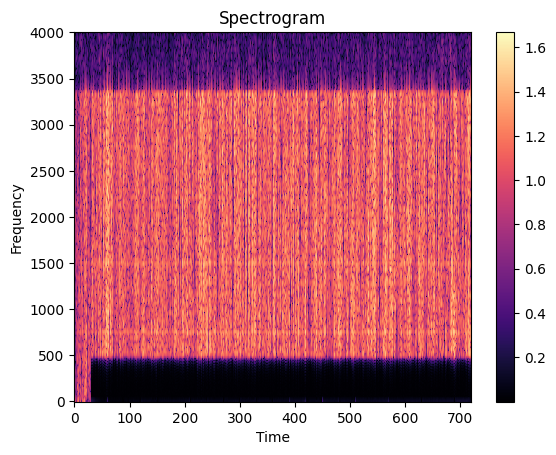

Number 1 most similar trained signal: 7552000_1576684440_7556000_1576684470, Types: ['DRM'], Similarity: 0.9904943704605103

Seen on: 2019-12-18 15:54:00


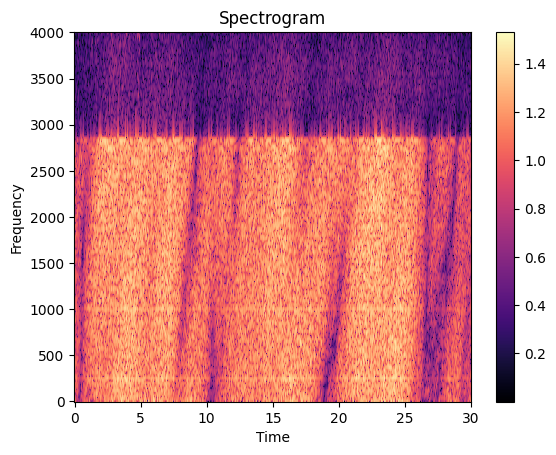

Number 2 most similar trained signal: 7552000_1576684260_7556000_1576684440, Types: ['DRM'], Similarity: 0.9899665713310242

Seen on: 2019-12-18 15:51:00


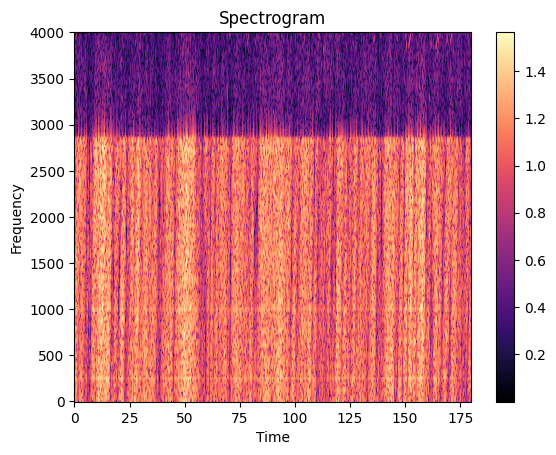

Number 3 most similar trained signal: 7552000_1576683600_7556000_1576683960, Types: ['DRM'], Similarity: 0.9880276918411255

Seen on: 2019-12-18 15:40:00


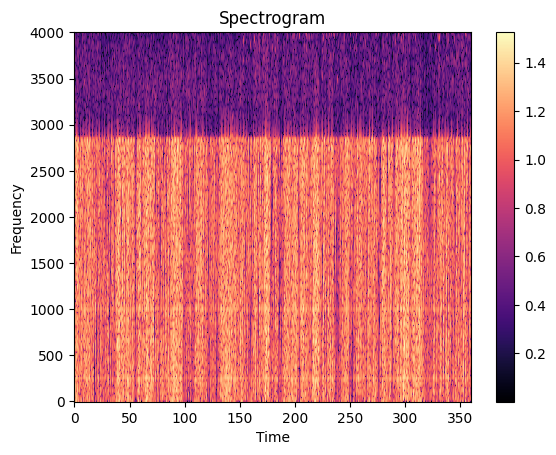

The signal is most likely a DRM signal.

File not found: information/DRM.txt
Tested Signal:


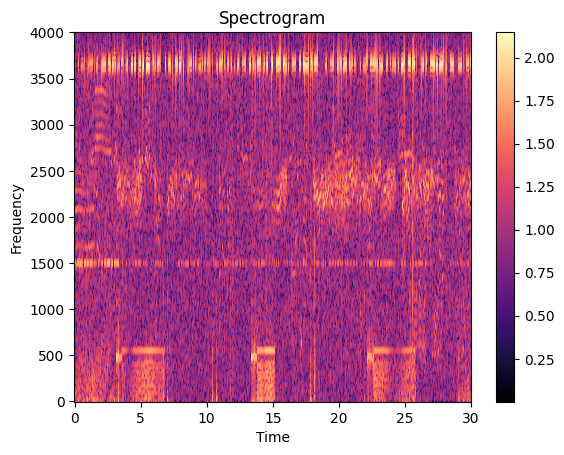

Number 1 most similar trained signal: 6692000_1576681680_6696000_1576681710, Types: ['Speech', 'Morse'], Similarity: 0.9824337959289551

Seen on: 2019-12-18 15:08:00


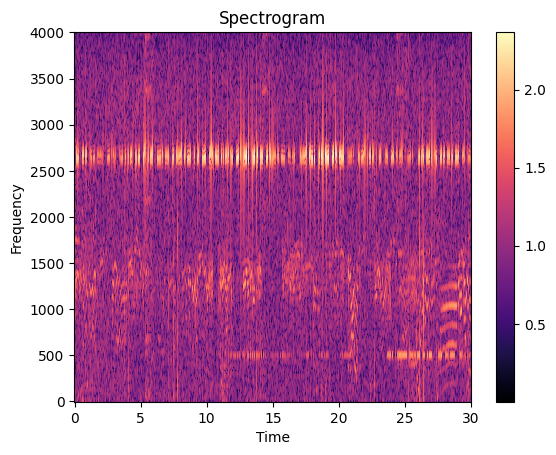

Number 2 most similar trained signal: 6692000_1576681650_6696000_1576681680, Types: ['Speech', 'Morse'], Similarity: 0.981293797492981

Seen on: 2019-12-18 15:07:30


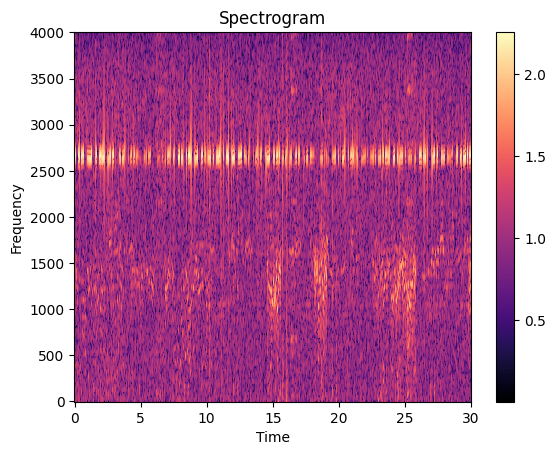

Number 3 most similar trained signal: 7168000_1576682400_7172000_1576682430, Types: ['Speech'], Similarity: 0.9731643199920654

Seen on: 2019-12-18 15:20:00


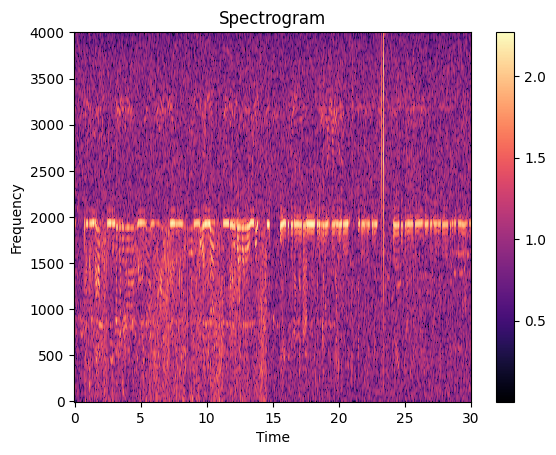

The signal is most likely a Speech signal.

Tested Signal:


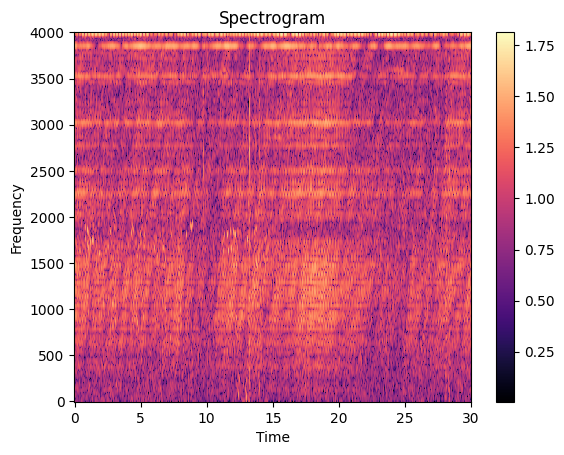

Number 1 most similar trained signal: 5871500_1576682703_5875500_1576682760, Types: ['JSM'], Similarity: 0.9795212745666504

Seen on: 2019-12-18 15:25:03


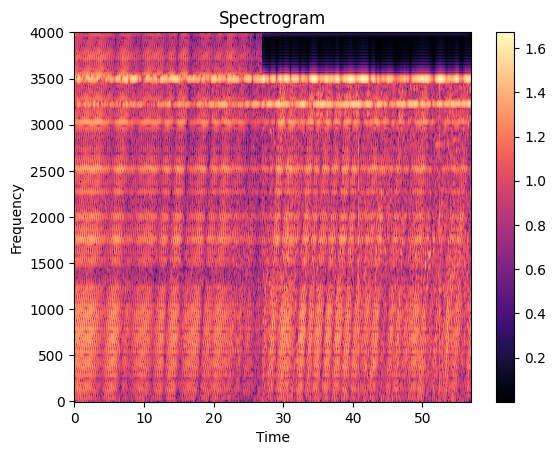

Number 2 most similar trained signal: 5871000_1576683420_5875000_1576683450, Types: ['Speech'], Similarity: 0.9783185720443726

Seen on: 2019-12-18 15:37:00


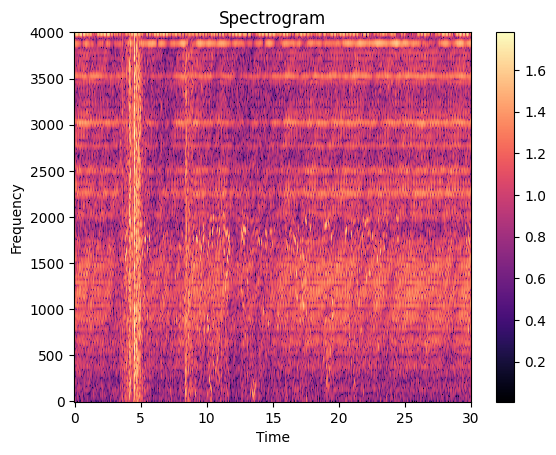

Number 3 most similar trained signal: 8587000_1576684650_8591000_1576684680, Types: ['JSM'], Similarity: 0.9748931527137756

Seen on: 2019-12-18 15:57:30


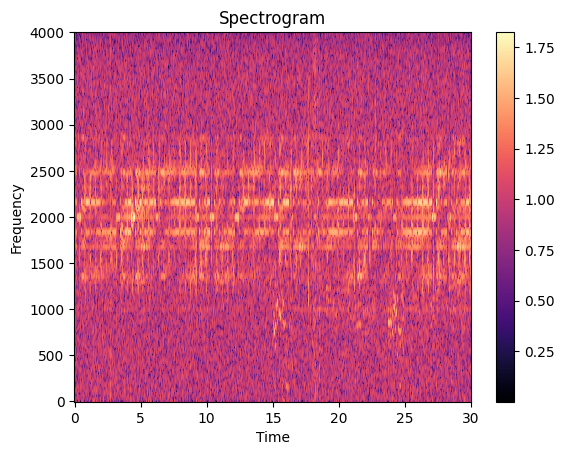

The signal is most likely a JSM signal.

JSM stands for "Jump Set Marker" and is a type of signal used in radio communications and telecommunications. JSM signals are short bursts of radio frequency transmitted to mark specific points or events within a data transmission or communication sequence.

In the context of radio communications, JSM signals are used for various purposes, including synchronization, timing, and error correction. They serve as reference markers that help receivers identify specific portions of transmitted data, allowing for accurate data retrieval and decoding.

JSM signals are commonly used in digital communication systems, such as satellite communication, wireless communication, and data transmission over networks. They play a critical role in ensuring the integrity and reliability of the transmitted data, especially in environments with potential signal interference or noise.

Tested Signal:


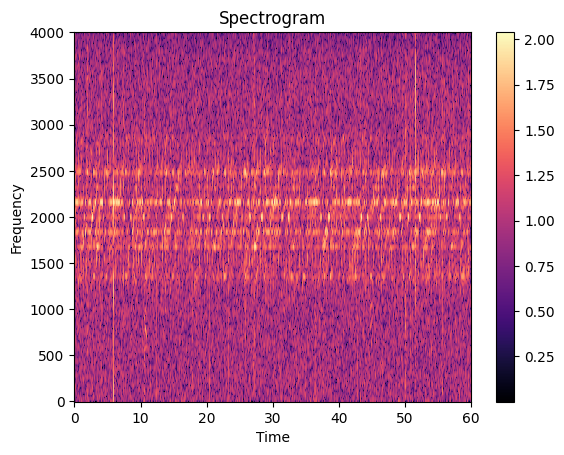

Number 1 most similar trained signal: 6444000_1576682520_6448000_1576682580, Types: ['JSM'], Similarity: 0.9881025552749634

Seen on: 2019-12-18 15:22:00


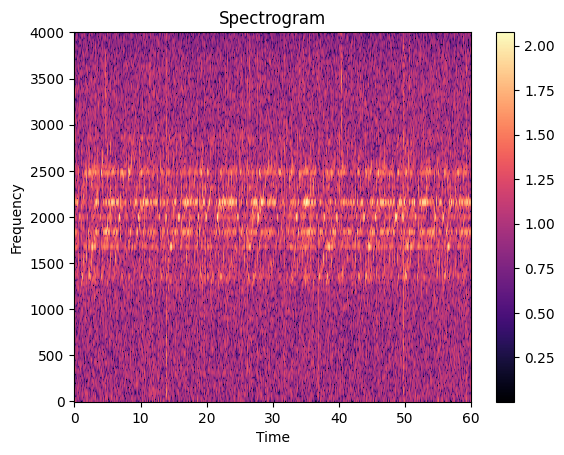

Number 2 most similar trained signal: 6416000_1576682760_6420000_1576682877, Types: ['JSM'], Similarity: 0.9843086004257202

Seen on: 2019-12-18 15:26:00


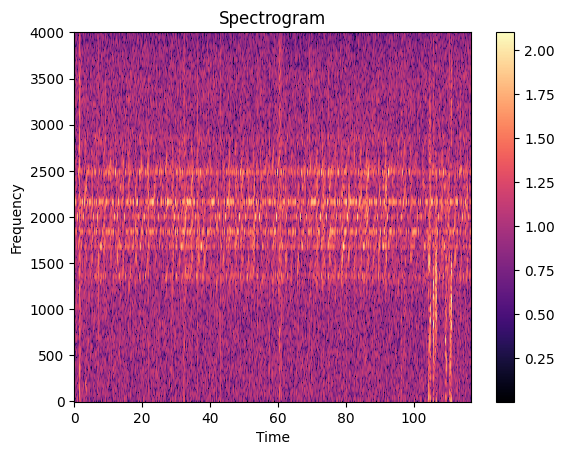

Number 3 most similar trained signal: 6416000_1576683720_6420000_1576683774, Types: ['JSM'], Similarity: 0.982224702835083

Seen on: 2019-12-18 15:42:00


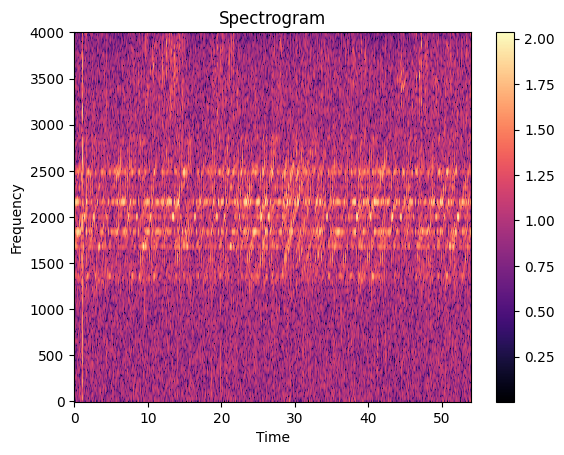

The signal is most likely a JSM signal.

JSM stands for "Jump Set Marker" and is a type of signal used in radio communications and telecommunications. JSM signals are short bursts of radio frequency transmitted to mark specific points or events within a data transmission or communication sequence.

In the context of radio communications, JSM signals are used for various purposes, including synchronization, timing, and error correction. They serve as reference markers that help receivers identify specific portions of transmitted data, allowing for accurate data retrieval and decoding.

JSM signals are commonly used in digital communication systems, such as satellite communication, wireless communication, and data transmission over networks. They play a critical role in ensuring the integrity and reliability of the transmitted data, especially in environments with potential signal interference or noise.

Tested Signal:


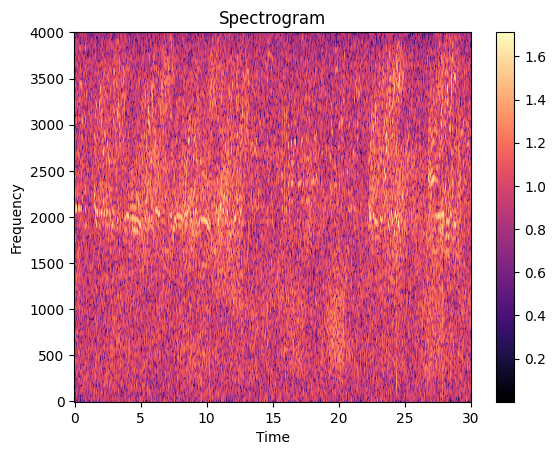

Number 1 most similar trained signal: 6570000_1576681320_6574000_1576681350, Types: ['Speech'], Similarity: 0.9904788136482239

Seen on: 2019-12-18 15:02:00


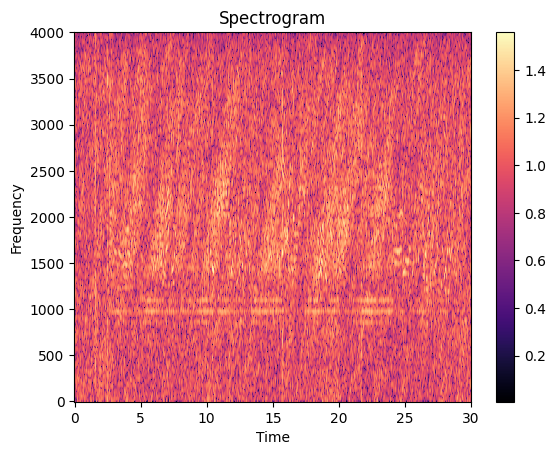

Number 2 most similar trained signal: 8538000_1576684173_8542000_1576684230, Types: ['Speech', 'PSK'], Similarity: 0.9876506924629211

Seen on: 2019-12-18 15:49:33


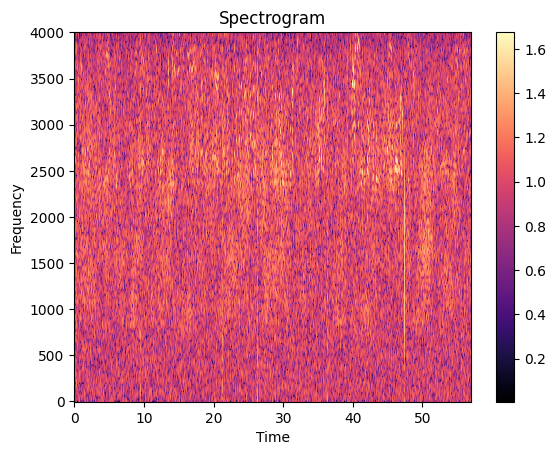

Number 3 most similar trained signal: 8492000_1576683921_8496000_1576683960, Types: ['Speech', 'PSK'], Similarity: 0.9875088930130005

Seen on: 2019-12-18 15:45:21


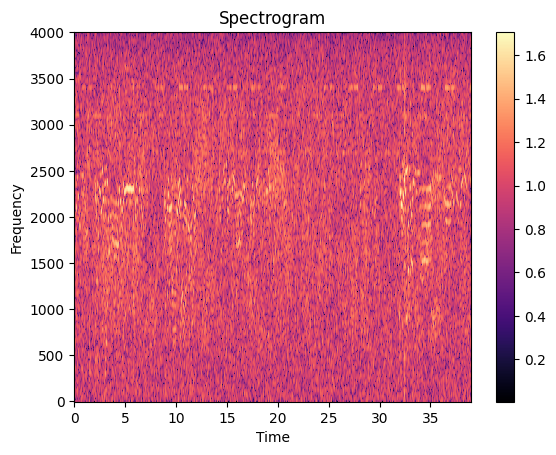

The signal is most likely a Speech signal.

Tested Signal:


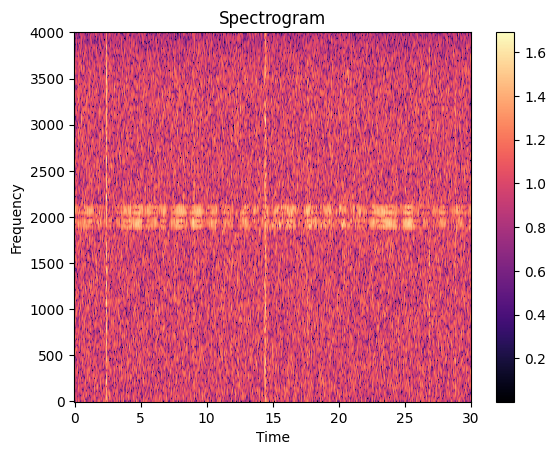

Number 1 most similar trained signal: 9364000_1576683681_9368000_1576683711, Types: ['2FSK200'], Similarity: 0.9737146496772766

Seen on: 2019-12-18 15:41:21


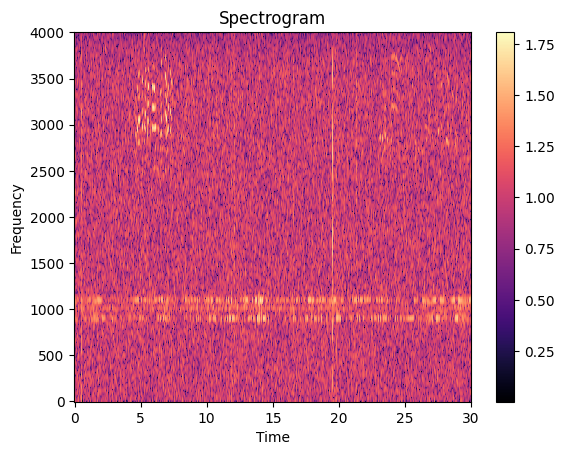

Number 2 most similar trained signal: 8338000_1576684320_8342000_1576684350, Types: ['Speech', 'P3'], Similarity: 0.9597841501235962

Seen on: 2019-12-18 15:52:00


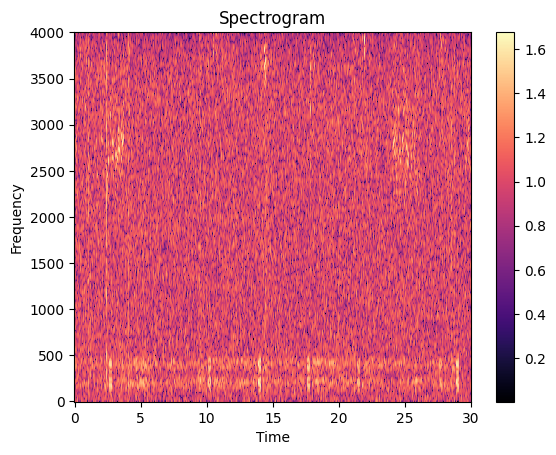

Number 3 most similar trained signal: 9363000_1576683900_9367000_1576683930, Types: ['2FSK200'], Similarity: 0.9580346345901489

Seen on: 2019-12-18 15:45:00


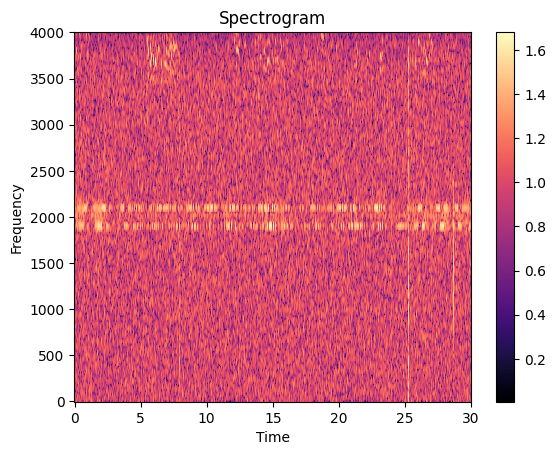

The signal is most likely a 2FSK200 signal.

2FSK200 refers to a signal that utilizes Frequency Shift Keying (FSK) modulation technique with a frequency separation of 200 Hz between the two frequencies used for encoding data. FSK is a digital modulation method commonly used in communication systems to transmit binary information. In 2FSK, two different frequencies are used to represent the two binary states (0 and 1) of the transmitted data, and the frequency difference between these two tones is 200 Hz. The signal may be used in various applications, including wireless communication and digital data transmission.

Tested Signal:


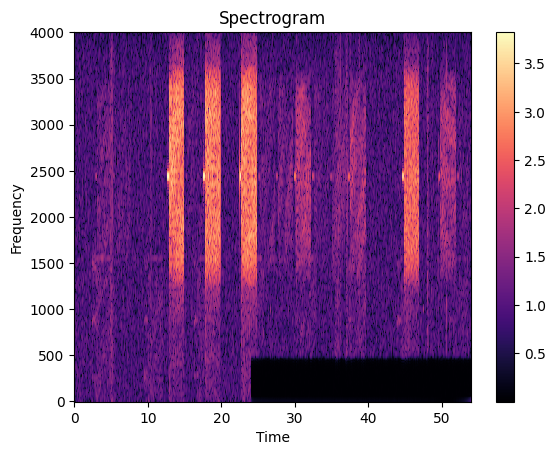

Number 1 most similar trained signal: 5654000_1576683660_5658000_1576683690, Types: ['HFDL'], Similarity: 0.9931970238685608

Seen on: 2019-12-18 15:41:00


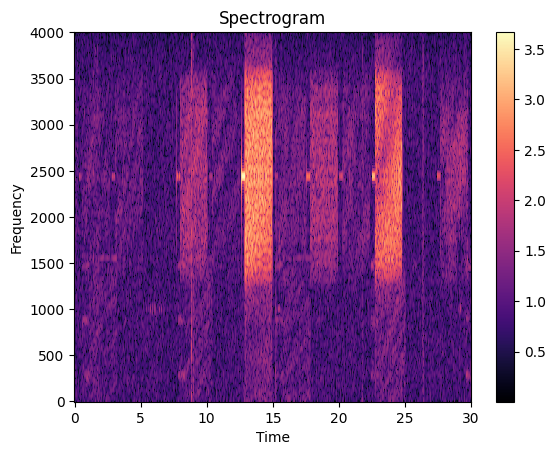

Number 2 most similar trained signal: 5654000_1576682820_5658000_1576682907, Types: ['HFDL'], Similarity: 0.9927374720573425

Seen on: 2019-12-18 15:27:00


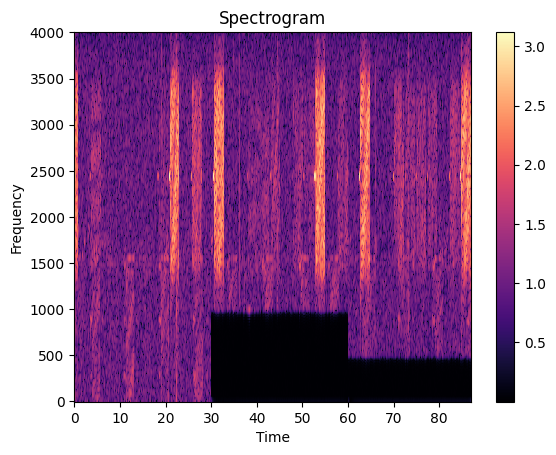

Number 3 most similar trained signal: 5654000_1576684560_5658000_1576684605, Types: ['HFDL'], Similarity: 0.9920375347137451

Seen on: 2019-12-18 15:56:00


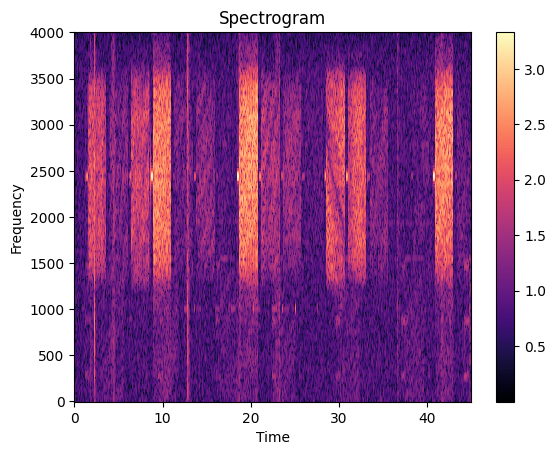

The signal is most likely a HFDL signal.

HFDL (High-Frequency Data Link) is a communication protocol extensively used in aviation for long-range data exchange between aircraft and ground stations. Operating within the high-frequency (HF) radio band, typically between 2 to 30 MHz, HFDL enables reliable transmission of messages, position reports, weather updates, and other critical data between aircraft and airline operations centers. Employing various modulation and error correction techniques, HFDL ensures secure and efficient flight tracking and monitoring, contributing to enhanced aviation safety and operational efficiency, particularly in remote regions or oceanic routes. Its robust data link layer protocol facilitates seamless communication, making it an indispensable tool in modern aviation systems.

Tested Signal:


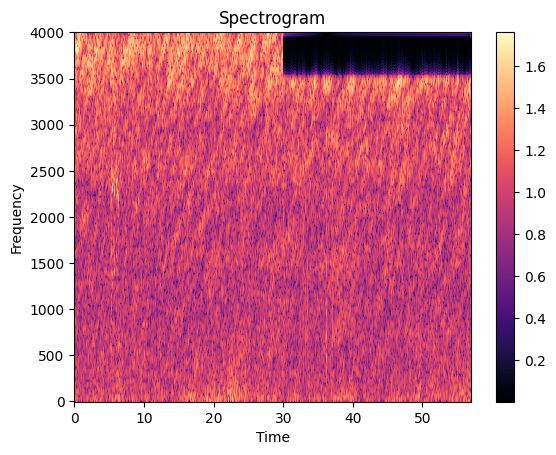

Number 1 most similar trained signal: 6351000_1576683240_6355000_1576683387, Types: ['Noise'], Similarity: 0.9942875504493713

Seen on: 2019-12-18 15:34:00


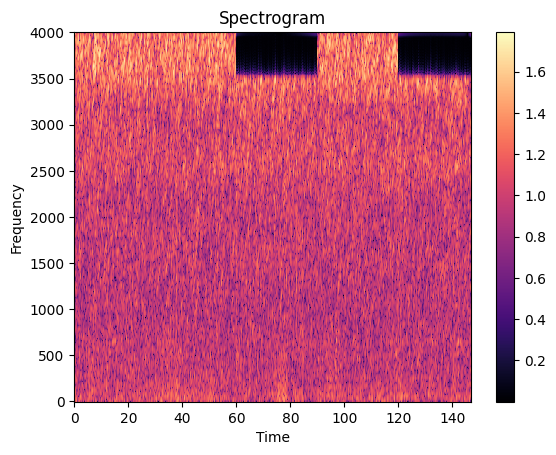

Number 2 most similar trained signal: 6351000_1576683000_6355000_1576683090, Types: ['Noise'], Similarity: 0.9923534393310547

Seen on: 2019-12-18 15:30:00


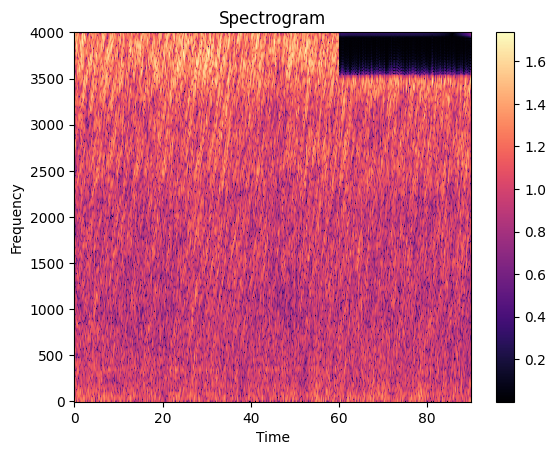

Number 3 most similar trained signal: 6351000_1576684680_6355000_1576684710, Types: ['Noise'], Similarity: 0.9919387698173523

Seen on: 2019-12-18 15:58:00


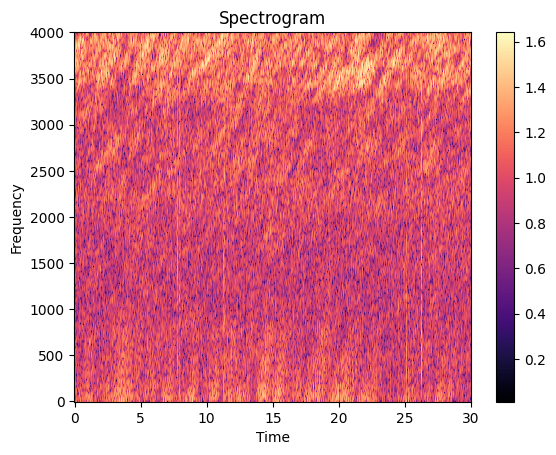

The signal is most likely a Noise signal.

Tested Signal:


KeyboardInterrupt: 

In [13]:
# visualise the effectiveness of the model
for wav_file in test_files:
    get_k_most_similar(wav_file, cosineIndex, test_files, model, 3)

Final results:


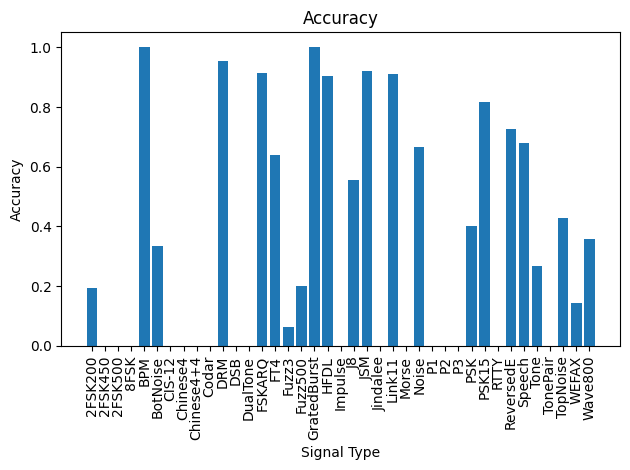

Overall accuracy: 0.7809224318658281


In [41]:
# Overall results
K_Neighbours = 3

distance, I2 = cosineIndex.search(test_arr_tmp, K_Neighbours+1)

total_correct = 0
correctly_labelled = {}
number_in_class = {}
for c in pickles["FB_18Dec2019_specgenCL0005_ShortPatience"]['Classes']:
    correctly_labelled[c] = 0
    number_in_class[c] = 0

for i in range(len(test_files)):
    if (I2[i][0]!=-1):
        file_name = os.path.basename(test_files[i])
        file_name = os.path.splitext(file_name)[0]
        correct_types = pickles["FB_18Dec2019_specgenCL0005_ShortPatience"]['GTLabelnamesAll'][file_name]

        for label in correct_types:
            number_in_class[label] += 1

        votes = {}
        
        # filter only results with at least 0.9 cosine similarity
        y = len(np.array(distance[i])[np.array(distance[i]) > 0.9])
        
        for j in range(1, y):
            idx = I2[i][j]
            folder_name = os.path.basename(os.path.dirname(test_files[idx]))
            test_file_name = os.path.basename(test_files[idx])
            test_file_name = os.path.splitext(test_file_name)[0]
            types = pickles[folder_name]['GTLabelnamesAll'][test_file_name]
            
            for type in types:
                if type not in votes:
                    votes[type] = 0
                votes[type] += 1

        if y-1 > 0:
            label = max(votes, key=votes.get)
            if label in correct_types:
                correctly_labelled[label] += 1
                total_correct += 1

torch.cuda.empty_cache()
gc.collect()

print("Final results:")
accuracy = {}
for c in pickles["FB_18Dec2019_specgenCL0005_ShortPatience"]['Classes']:
    if number_in_class[c] > 0:
        accuracy[c] = correctly_labelled[c]/number_in_class[c]

keys = list(accuracy.keys())
values = list(accuracy.values())
plt.bar(keys, values)
plt.xlabel('Signal Type')
plt.ylabel('Accuracy')
plt.title("Accuracy")
plt.xticks(rotation=90)
plt.tight_layout()
plt.savefig("finetuned_30.png")
plt.show()


print(f"Overall accuracy: {total_correct/len(test_files)}")